In [1]:
# load the dataset from the csv file using pandas
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
from tensorflow import keras
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Dropout
from keras import regularizers
from keras import optimizers
from keras import backend as K
from keras.callbacks import EarlyStopping
from keras.callbacks import ModelCheckpoint
from keras.models import load_model
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import roc_curve
from sklearn.metrics import auc
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import average_precision_score
from sklearn.metrics import f1_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import recall_score

# load the dataset from the csv file using pandas
df = pd.read_csv('diabetes.csv')
df.head()


,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1


In [2]:
# Replace the 0 values with NA except for the [Pregnancies, Outcome, DiabetesPedigreeFunction, Age] columns
df_copy = df.copy(deep = True)
df_copy[['Glucose', 'BloodPressure', 'SkinThickness', 'Insulin', 'BMI']] = df_copy[['Glucose', 'BloodPressure', 'SkinThickness', 'Insulin', 'BMI']].replace(0, np.NaN)
df_copy.head()


,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.0,NaN,33.6,0.627,50,1
1,1,85.0,66.0,29.0,NaN,26.6,0.351,31,0
2,8,183.0,64.0,NaN,NaN,23.3,0.672,32,1
3,1,89.0,66.0,23.0,94.0,28.1,0.167,21,0
4,0,137.0,40.0,35.0,168.0,43.1,2.288,33,1


In [3]:
# fill in the missing data with the median value of the column
df_copy.fillna(df_copy.median(), inplace = True)


In [4]:
# scale the data using min_max except for outcome column
df_copy_scaled = df_copy.copy(deep = True)
df_copy_scaled[['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin', 'BMI', 'DiabetesPedigreeFunction', 'Age']] = df_copy_scaled[['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin', 'BMI', 'DiabetesPedigreeFunction', 'Age']].apply(lambda x: (x - x.min()) / (x.max() - x.min()))


In [5]:
# Split the data into training and test sets
X = df_copy_scaled.drop(columns = ['Outcome'])
y = df_copy_scaled['Outcome']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.1, random_state=5)


In [6]:
# create a deep learning model with 3 hidden layers
model = Sequential([
    Dense(8, activation = 'relu', input_shape = (8,)),
    Dense(4, activation = 'relu'),
    Dense(2, activation = 'relu'),
    Dense(1, activation = 'sigmoid'),
])
model.compile(optimizer = 'adam', loss = 'binary_crossentropy', metrics = ['accuracy'])

In [7]:
# train the model
earlystoping = EarlyStopping(monitor = 'loss', mode = 'min', verbose = 1, patience = 100)
model.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split = 0.1, verbose = 2, callbacks=[earlystoping])

Epoch 1/1000
20/20 - 2s - loss: 0.6824 - accuracy: 0.6425 - val_loss: 0.6717 - val_accuracy: 0.6857 - 2s/epoch - 78ms/step
Epoch 2/1000
20/20 - 0s - loss: 0.6738 - accuracy: 0.6425 - val_loss: 0.6556 - val_accuracy: 0.6857 - 61ms/epoch - 3ms/step
Epoch 3/1000
20/20 - 0s - loss: 0.6651 - accuracy: 0.6425 - val_loss: 0.6412 - val_accuracy: 0.6857 - 60ms/epoch - 3ms/step
Epoch 4/1000
20/20 - 0s - loss: 0.6576 - accuracy: 0.6425 - val_loss: 0.6321 - val_accuracy: 0.6857 - 62ms/epoch - 3ms/step
Epoch 5/1000
20/20 - 0s - loss: 0.6536 - accuracy: 0.6425 - val_loss: 0.6212 - val_accuracy: 0.6857 - 58ms/epoch - 3ms/step
Epoch 6/1000
20/20 - 0s - loss: 0.6471 - accuracy: 0.6425 - val_loss: 0.6138 - val_accuracy: 0.6857 - 61ms/epoch - 3ms/step
Epoch 7/1000
20/20 - 0s - loss: 0.6416 - accuracy: 0.6425 - val_loss: 0.6047 - val_accuracy: 0.6857 - 60ms/epoch - 3ms/step
Epoch 8/1000
20/20 - 0s - loss: 0.6360 - accuracy: 0.6425 - val_loss: 0.5970 - val_accuracy: 0.6857 - 60ms/epoch - 3ms/step
Epoch 9/1

In [8]:
model.evaluate(X_test, y_test, verbose = 2)

3/3 - 0s - loss: 0.3961 - accuracy: 0.8052 - 19ms/epoch - 6ms/step


[0.39613768458366394, 0.8051947951316833]

In [34]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from scikeras.wrappers import KerasClassifier
from sklearn.model_selection import GridSearchCV

# create a deep learning model with multiple hidden layers
def create_model(layers=1, neurons=8):  # Setting default values
    model = Sequential()
    
    # If layers=0, create a simple perceptron
    if layers == 0:
        model.add(Dense(1, activation='sigmoid', input_shape=(8,)))
    else:
        # The first layer should have the input_shape argument
        model.add(Dense(neurons, activation='relu', input_shape=(8,)))
        for i in range(1, layers):  # start from 1 because we've already added the first layer
            model.add(Dense(neurons, activation='relu'))
        model.add(Dense(1, activation='sigmoid'))
    
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model


early_stop = EarlyStopping(monitor='loss', patience=50, restore_best_weights=True)

model = KerasClassifier(model=create_model, epochs=1000, verbose=2, layers=1, neurons=8, callbacks=[early_stop])

layers = [0, 1, 2, 3, 4, 5]
neurons = [1, 2, 4, 8, 16, 32]

param_grid = dict(layers=layers, neurons=neurons)

grid = GridSearchCV(estimator=model, param_grid=param_grid, cv=5)

grid_result = grid.fit(X_train, y_train)

# summarize results
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))


Epoch 1/1000
18/18 - 0s - loss: 0.6863 - accuracy: 0.6123 - 421ms/epoch - 23ms/step
Epoch 2/1000
18/18 - 0s - loss: 0.6850 - accuracy: 0.6159 - 22ms/epoch - 1ms/step
Epoch 3/1000
18/18 - 0s - loss: 0.6836 - accuracy: 0.6214 - 25ms/epoch - 1ms/step
Epoch 4/1000
18/18 - 0s - loss: 0.6823 - accuracy: 0.6232 - 23ms/epoch - 1ms/step
Epoch 5/1000
18/18 - 0s - loss: 0.6812 - accuracy: 0.6286 - 25ms/epoch - 1ms/step
Epoch 6/1000
18/18 - 0s - loss: 0.6800 - accuracy: 0.6304 - 24ms/epoch - 1ms/step
Epoch 7/1000
18/18 - 0s - loss: 0.6789 - accuracy: 0.6304 - 26ms/epoch - 1ms/step
Epoch 8/1000
18/18 - 0s - loss: 0.6778 - accuracy: 0.6304 - 23ms/epoch - 1ms/step
Epoch 9/1000
18/18 - 0s - loss: 0.6766 - accuracy: 0.6322 - 39ms/epoch - 2ms/step
Epoch 10/1000
18/18 - 0s - loss: 0.6755 - accuracy: 0.6359 - 22ms/epoch - 1ms/step
Epoch 11/1000
18/18 - 0s - loss: 0.6743 - accuracy: 0.6377 - 27ms/epoch - 2ms/step
Epoch 12/1000
18/18 - 0s - loss: 0.6732 - accuracy: 0.6377 - 26ms/epoch - 1ms/step
Epoch 13/10

In [19]:
model = create_model(layers=grid_result.best_params_['layers'], neurons=grid_result.best_params_['neurons'])
model.fit(X_train, y_train, epochs=1000, verbose=2,callbacks=[early_stop])
model.evaluate(X_test, y_test, verbose=2)

Epoch 1/1000
22/22 - 1s - loss: 0.6887 - accuracy: 0.6165 - 1s/epoch - 58ms/step
Epoch 2/1000
22/22 - 0s - loss: 0.6806 - accuracy: 0.6469 - 47ms/epoch - 2ms/step
Epoch 3/1000
22/22 - 0s - loss: 0.6729 - accuracy: 0.6498 - 46ms/epoch - 2ms/step
Epoch 4/1000
22/22 - 0s - loss: 0.6650 - accuracy: 0.6498 - 43ms/epoch - 2ms/step
Epoch 5/1000
22/22 - 0s - loss: 0.6560 - accuracy: 0.6541 - 45ms/epoch - 2ms/step
Epoch 6/1000
22/22 - 0s - loss: 0.6457 - accuracy: 0.6628 - 45ms/epoch - 2ms/step
Epoch 7/1000
22/22 - 0s - loss: 0.6342 - accuracy: 0.6686 - 45ms/epoch - 2ms/step
Epoch 8/1000
22/22 - 0s - loss: 0.6208 - accuracy: 0.6816 - 44ms/epoch - 2ms/step
Epoch 9/1000
22/22 - 0s - loss: 0.6078 - accuracy: 0.7077 - 44ms/epoch - 2ms/step
Epoch 10/1000
22/22 - 0s - loss: 0.5916 - accuracy: 0.7048 - 44ms/epoch - 2ms/step
Epoch 11/1000
22/22 - 0s - loss: 0.5751 - accuracy: 0.7192 - 44ms/epoch - 2ms/step
Epoch 12/1000
22/22 - 0s - loss: 0.5640 - accuracy: 0.7106 - 43ms/epoch - 2ms/step
Epoch 13/1000


[0.46269577741622925, 0.7532467246055603]

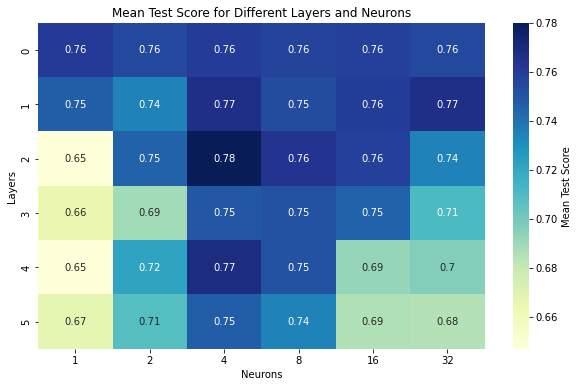

In [35]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

# Convert the grid results into a DataFrame
df = pd.DataFrame(grid_result.cv_results_)

# Pivot the DataFrame to get a matrix-like structure
heatmap_data = df.pivot(index='param_layers', columns='param_neurons', values='mean_test_score')

# Plot the heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(heatmap_data, annot=True, cmap='YlGnBu', cbar_kws={'label': 'Mean Test Score'})
plt.title('Mean Test Score for Different Layers and Neurons')
plt.xlabel('Neurons')
plt.ylabel('Layers')
plt.show()


In [18]:
# create another grid search with L1 and L2 regularization
from scikeras.wrappers import KerasClassifier
from sklearn.model_selection import GridSearchCV
def create_model(l1=0.0, l2=0.0):  # Setting default values
    model = Sequential([
        Dense(1, activation='sigmoid', input_shape=(8,),kernel_regularizer=regularizers.l1_l2(l1=l1, l2=l2)),
    ])  
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

# summarize results
early_stop = EarlyStopping(monitor='loss', patience=50, restore_best_weights=True)

model = KerasClassifier(model=create_model,l1=0.0,l2=0.2, epochs=1000, verbose=2, callbacks=[early_stop])

l1 = [0.0, 0.0001, 0.001, 0.01]
l2 = [0.0, 0.0001, 0.001, 0.01]

param_grid = {'l1': l1, 'l2': l2}

grid = GridSearchCV(estimator=model, param_grid=param_grid, cv=5)

grid_result_l1_l2 = grid.fit(X_train, y_train)

# summarize results
print("Best: %f using %s" % (grid_result_l1_l2.best_score_, grid_result_l1_l2.best_params_))

Epoch 1/1000
18/18 - 1s - loss: 0.7132 - accuracy: 0.3678 - 657ms/epoch - 37ms/step
Epoch 2/1000
18/18 - 0s - loss: 0.6940 - accuracy: 0.5181 - 27ms/epoch - 1ms/step
Epoch 3/1000
18/18 - 0s - loss: 0.6811 - accuracy: 0.6431 - 30ms/epoch - 2ms/step
Epoch 4/1000
18/18 - 0s - loss: 0.6733 - accuracy: 0.6467 - 29ms/epoch - 2ms/step
Epoch 5/1000
18/18 - 0s - loss: 0.6674 - accuracy: 0.6467 - 28ms/epoch - 2ms/step
Epoch 6/1000
18/18 - 0s - loss: 0.6619 - accuracy: 0.6467 - 31ms/epoch - 2ms/step
Epoch 7/1000
18/18 - 0s - loss: 0.6573 - accuracy: 0.6467 - 28ms/epoch - 2ms/step
Epoch 8/1000
18/18 - 0s - loss: 0.6528 - accuracy: 0.6467 - 28ms/epoch - 2ms/step
Epoch 9/1000
18/18 - 0s - loss: 0.6490 - accuracy: 0.6467 - 28ms/epoch - 2ms/step
Epoch 10/1000
18/18 - 0s - loss: 0.6449 - accuracy: 0.6467 - 28ms/epoch - 2ms/step
Epoch 11/1000
18/18 - 0s - loss: 0.6413 - accuracy: 0.6467 - 28ms/epoch - 2ms/step
Epoch 12/1000
18/18 - 0s - loss: 0.6377 - accuracy: 0.6467 - 38ms/epoch - 2ms/step
Epoch 13/10

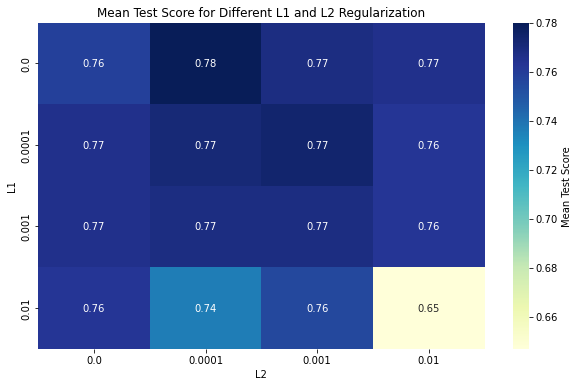

In [22]:
# draw heatmap for L1 and L2 regularization
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

# Convert the grid results into a DataFrame
df = pd.DataFrame(grid_result_l1_l2.cv_results_)
# Pivot the DataFrame to get a matrix-like structure

heatmap_data = df.pivot(index='param_l1', columns='param_l2', values='mean_test_score')

# Plot the heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(heatmap_data, annot=True, cmap='YlGnBu', cbar_kws={'label': 'Mean Test Score'})
plt.title('Mean Test Score for Different L1 and L2 Regularization')
plt.xlabel('L2')
plt.ylabel('L1')
plt.show()

In [19]:
model = create_model(l1=grid_result_l1_l2.best_params_['l1'], l2=grid_result_l1_l2.best_params_['l2'])
model.fit(X_train, y_train, epochs=1000, verbose=2,callbacks=[early_stop])
model.evaluate(X_test, y_test, verbose=2)

Epoch 1/1000
22/22 - 1s - loss: 0.6893 - accuracy: 0.6324 - 680ms/epoch - 31ms/step
Epoch 2/1000
22/22 - 0s - loss: 0.6807 - accuracy: 0.6469 - 35ms/epoch - 2ms/step
Epoch 3/1000
22/22 - 0s - loss: 0.6727 - accuracy: 0.6469 - 35ms/epoch - 2ms/step
Epoch 4/1000
22/22 - 0s - loss: 0.6647 - accuracy: 0.6469 - 34ms/epoch - 2ms/step
Epoch 5/1000
22/22 - 0s - loss: 0.6588 - accuracy: 0.6469 - 35ms/epoch - 2ms/step
Epoch 6/1000
22/22 - 0s - loss: 0.6534 - accuracy: 0.6469 - 34ms/epoch - 2ms/step
Epoch 7/1000
22/22 - 0s - loss: 0.6489 - accuracy: 0.6469 - 34ms/epoch - 2ms/step
Epoch 8/1000
22/22 - 0s - loss: 0.6447 - accuracy: 0.6469 - 40ms/epoch - 2ms/step
Epoch 9/1000
22/22 - 0s - loss: 0.6409 - accuracy: 0.6469 - 34ms/epoch - 2ms/step
Epoch 10/1000
22/22 - 0s - loss: 0.6369 - accuracy: 0.6469 - 35ms/epoch - 2ms/step
Epoch 11/1000
22/22 - 0s - loss: 0.6329 - accuracy: 0.6469 - 34ms/epoch - 2ms/step
Epoch 12/1000
22/22 - 0s - loss: 0.6292 - accuracy: 0.6469 - 35ms/epoch - 2ms/step
Epoch 13/10

[0.39448583126068115, 0.7792207598686218]

In [20]:

# create another grid search with dropout regularization
from scikeras.wrappers import KerasClassifier
from sklearn.model_selection import GridSearchCV
def create_model(dropout_rate=0.0):  # Setting default values
    model = Sequential([
        Dense(8, activation='relu', input_shape=(8,)),
        Dropout(dropout_rate),
        Dense(1, activation='sigmoid'),
    ])  
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model


# summarize results
early_stop = EarlyStopping(monitor='loss', patience=50, restore_best_weights=True)

model = KerasClassifier(model=create_model,dropout_rate=0.0, epochs=1000, verbose=2, callbacks=[early_stop])

dropout_rate = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5]

param_grid = {'dropout_rate': dropout_rate}

grid = GridSearchCV(estimator=model, param_grid=param_grid, cv=5)

grid_result_dropout = grid.fit(X_train, y_train)

# summarize results

print("Best: %f using %s" % (grid_result_dropout.best_score_, grid_result_dropout.best_params_))

Epoch 1/1000
18/18 - 1s - loss: 0.7222 - accuracy: 0.3949 - 626ms/epoch - 35ms/step
Epoch 2/1000
18/18 - 0s - loss: 0.6987 - accuracy: 0.4764 - 26ms/epoch - 1ms/step
Epoch 3/1000
18/18 - 0s - loss: 0.6832 - accuracy: 0.5761 - 32ms/epoch - 2ms/step
Epoch 4/1000
18/18 - 0s - loss: 0.6714 - accuracy: 0.6431 - 28ms/epoch - 2ms/step
Epoch 5/1000
18/18 - 0s - loss: 0.6631 - accuracy: 0.6739 - 30ms/epoch - 2ms/step
Epoch 6/1000
18/18 - 0s - loss: 0.6572 - accuracy: 0.6558 - 28ms/epoch - 2ms/step
Epoch 7/1000
18/18 - 0s - loss: 0.6510 - accuracy: 0.6522 - 28ms/epoch - 2ms/step
Epoch 8/1000
18/18 - 0s - loss: 0.6460 - accuracy: 0.6522 - 28ms/epoch - 2ms/step
Epoch 9/1000
18/18 - 0s - loss: 0.6410 - accuracy: 0.6449 - 27ms/epoch - 2ms/step
Epoch 10/1000
18/18 - 0s - loss: 0.6358 - accuracy: 0.6467 - 28ms/epoch - 2ms/step
Epoch 11/1000
18/18 - 0s - loss: 0.6311 - accuracy: 0.6558 - 27ms/epoch - 2ms/step
Epoch 12/1000
18/18 - 0s - loss: 0.6276 - accuracy: 0.6576 - 28ms/epoch - 2ms/step
Epoch 13/10

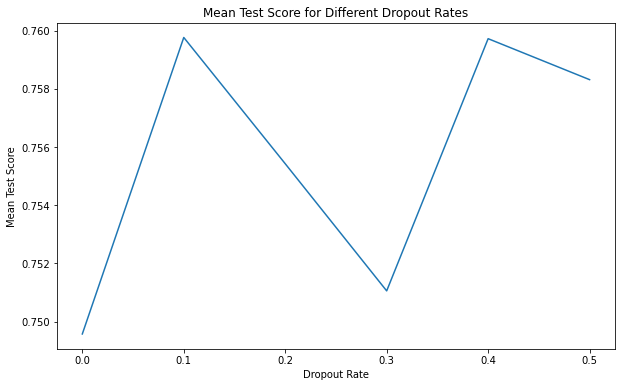

In [21]:
# draw chart for dropout

import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

# just draw line chart for dropout

df = pd.DataFrame(grid_result_dropout.cv_results_)
plt.figure(figsize=(10, 6))
plt.plot(df['param_dropout_rate'], df['mean_test_score'])
plt.title('Mean Test Score for Different Dropout Rates')
plt.xlabel('Dropout Rate')
plt.ylabel('Mean Test Score')
plt.show()

In [24]:
# test activation function
from scikeras.wrappers import KerasClassifier
from sklearn.model_selection import GridSearchCV

def create_model(activation='relu'):  # Setting default values
    model = Sequential([
        Dense(8, activation=activation, input_shape=(8,)),
        Dense(1, activation='sigmoid'),
    ])  
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

activation = ['relu', 'tanh', 'sigmoid', 'linear']

param_grid = {'activation': activation}

grid = GridSearchCV(estimator=KerasClassifier(model=create_model, activation="relu",epochs=1000, verbose=2), param_grid=param_grid, cv=5)

grid_result_activation = grid.fit(X_train, y_train)

# summarize results
print("Best: %f using %s" % (grid_result_activation.best_score_, grid_result_activation.best_params_))


Epoch 1/1000
18/18 - 1s - loss: 0.7141 - accuracy: 0.3659 - 616ms/epoch - 34ms/step
Epoch 2/1000
18/18 - 0s - loss: 0.7024 - accuracy: 0.4783 - 28ms/epoch - 2ms/step
Epoch 3/1000
18/18 - 0s - loss: 0.6943 - accuracy: 0.5453 - 24ms/epoch - 1ms/step
Epoch 4/1000
18/18 - 0s - loss: 0.6891 - accuracy: 0.6141 - 29ms/epoch - 2ms/step
Epoch 5/1000
18/18 - 0s - loss: 0.6842 - accuracy: 0.6359 - 28ms/epoch - 2ms/step
Epoch 6/1000
18/18 - 0s - loss: 0.6811 - accuracy: 0.6431 - 27ms/epoch - 2ms/step
Epoch 7/1000
18/18 - 0s - loss: 0.6784 - accuracy: 0.6413 - 26ms/epoch - 1ms/step
Epoch 8/1000
18/18 - 0s - loss: 0.6759 - accuracy: 0.6431 - 28ms/epoch - 2ms/step
Epoch 9/1000
18/18 - 0s - loss: 0.6739 - accuracy: 0.6431 - 28ms/epoch - 2ms/step
Epoch 10/1000
18/18 - 0s - loss: 0.6720 - accuracy: 0.6449 - 26ms/epoch - 1ms/step
Epoch 11/1000
18/18 - 0s - loss: 0.6704 - accuracy: 0.6449 - 27ms/epoch - 2ms/step
Epoch 12/1000
18/18 - 0s - loss: 0.6690 - accuracy: 0.6467 - 28ms/epoch - 2ms/step
Epoch 13/10

In [29]:
model = Sequential([
        Dense(1, activation='sigmoid', input_shape=(8,)),
    ])  

In [31]:
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
model.fit(X_train, y_train, epochs=1000, verbose=2,callbacks=[early_stop])



Epoch 1/1000


22/22 - 0s - loss: 0.8218 - accuracy: 0.3531 - 479ms/epoch - 22ms/step
Epoch 2/1000
22/22 - 0s - loss: 0.8044 - accuracy: 0.3531 - 28ms/epoch - 1ms/step
Epoch 3/1000
22/22 - 0s - loss: 0.7879 - accuracy: 0.3560 - 31ms/epoch - 1ms/step
Epoch 4/1000
22/22 - 0s - loss: 0.7733 - accuracy: 0.3560 - 29ms/epoch - 1ms/step
Epoch 5/1000
22/22 - 0s - loss: 0.7600 - accuracy: 0.3560 - 32ms/epoch - 1ms/step
Epoch 6/1000
22/22 - 0s - loss: 0.7481 - accuracy: 0.3589 - 31ms/epoch - 1ms/step
Epoch 7/1000
22/22 - 0s - loss: 0.7373 - accuracy: 0.3676 - 30ms/epoch - 1ms/step
Epoch 8/1000
22/22 - 0s - loss: 0.7280 - accuracy: 0.3806 - 30ms/epoch - 1ms/step
Epoch 9/1000
22/22 - 0s - loss: 0.7193 - accuracy: 0.4096 - 30ms/epoch - 1ms/step
Epoch 10/1000
22/22 - 0s - loss: 0.7117 - accuracy: 0.4240 - 27ms/epoch - 1ms/step
Epoch 11/1000
22/22 - 0s - loss: 0.7050 - accuracy: 0.4486 - 29ms/epoch - 1ms/step
Epoch 12/1000
22/22 - 0s - loss: 0.6992 - accuracy: 0.4660 - 29ms/epoch - 1ms/step
Epoch 13/1000
22/22 - 0s

In [32]:
model.evaluate(X_test, y_test, verbose=2)

3/3 - 0s - loss: 0.4347 - accuracy: 0.8052 - 80ms/epoch - 27ms/step


[0.43470141291618347, 0.8051947951316833]

In [33]:
model.summary()

Model: "sequential_136"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_275 (Dense)           (None, 1)                 9         
                                                                 
Total params: 9 (36.00 Byte)
Trainable params: 9 (36.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [28]:
model.summary()

Model: "sequential_135"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_273 (Dense)           (None, 8)                 72        
                                                                 
 dense_274 (Dense)           (None, 1)                 9         
                                                                 
Total params: 81 (324.00 Byte)
Trainable params: 81 (324.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


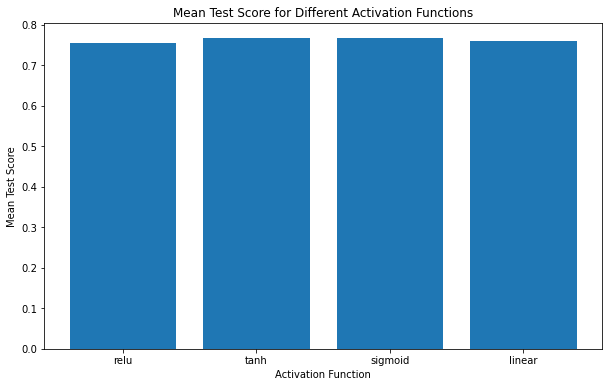

In [25]:
# using bar chart to show the result
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

# Convert the grid results into a DataFrame
df = pd.DataFrame(grid_result_activation.cv_results_)
# Pivot the DataFrame to get a matrix-like structure

plt.figure(figsize=(10, 6))
plt.bar(df['param_activation'], df['mean_test_score'])
plt.title('Mean Test Score for Different Activation Functions')
plt.xlabel('Activation Function')
plt.ylabel('Mean Test Score')
plt.show()